In [ ]:
from google.colab import drive
drive.mount('/content/drive')


In [ ]:
from google.colab import drive
import zipfile
import os

drive.mount('/content/drive')

zip_path = '/content/drive/MyDrive/image segmentation /RM_Segmentation_Assignment_dataset.zip'  # Update path
extract_dir = '/content/drive/MyDrive/image segmentation '

if not os.path.exists(extract_dir):
    os.makedirs(extract_dir)

with zipfile.ZipFile(zip_path, 'r') as zip_ref:
    zip_ref.extractall(extract_dir)

print(f"Extracted to {extract_dir}")


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
Extracted to /content/drive/MyDrive/image segmentation 


In [ ]:
import os
import json
import torch
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms as T
from PIL import Image
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import torchvision
from torchvision.models.detection.faster_rcnn import FastRCNNPredictor
from tqdm import tqdm
from pycocotools.coco import COCO


In [ ]:
import os

# Base directory where you extracted your dataset ZIP
extract_dir = '/content/drive/MyDrive/image segmentation '

# Dataset paths - adjust folder names exactly as they appear in your extracted folder
train_images_dir = os.path.join(extract_dir, '/content/drive/MyDrive/image segmentation /train-300')
train_ann_file = os.path.join(extract_dir, '/content/drive/MyDrive/image segmentation /train-300/labels.json')

val_images_dir = os.path.join(extract_dir, '/content/drive/MyDrive/image segmentation /validation-300')
val_ann_file = os.path.join(extract_dir, '/content/drive/MyDrive/image segmentation /validation-300/labels.json')

test_images_dir = os.path.join(extract_dir, '/content/drive/MyDrive/image segmentation /test-30')
# Note: no test annotations since your test data has only images

# Class names - background index 0 (needed for Faster R-CNN)
target_classes = ['__background__', 'car', 'person', 'cake', 'dog']

# Number of classes (background + 4)
num_classes = len(target_classes)

print("Paths and class names set:")
print(f"Train images: {train_images_dir}")
print(f"Train annotations: {train_ann_file}")
print(f"Val images: {val_images_dir}")
print(f"Val annotations: {val_ann_file}")
print(f"Test images: {test_images_dir}")
print(f"Classes: {target_classes}")
print(f"Num classes: {num_classes}")


Paths and class names set:
Train images: /content/drive/MyDrive/image segmentation /train-300
Train annotations: /content/drive/MyDrive/image segmentation /train-300/labels.json
Val images: /content/drive/MyDrive/image segmentation /validation-300
Val annotations: /content/drive/MyDrive/image segmentation /validation-300/labels.json
Test images: /content/drive/MyDrive/image segmentation /test-30
Classes: ['__background__', 'car', 'person', 'cake', 'dog']
Num classes: 5


loading annotations into memory...
Done (t=0.04s)
creating index...
index created!


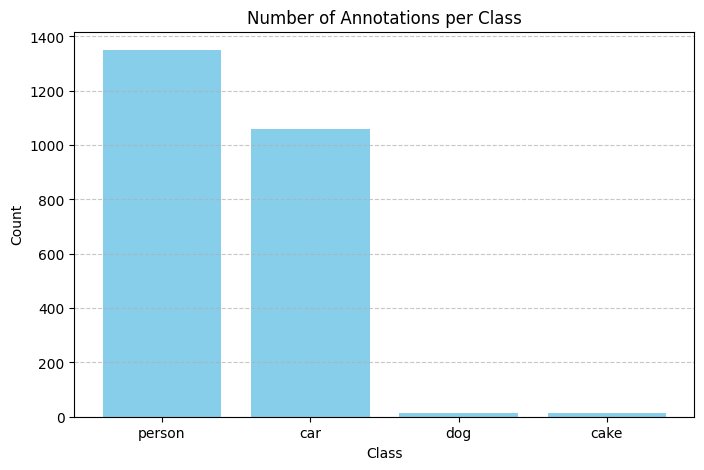

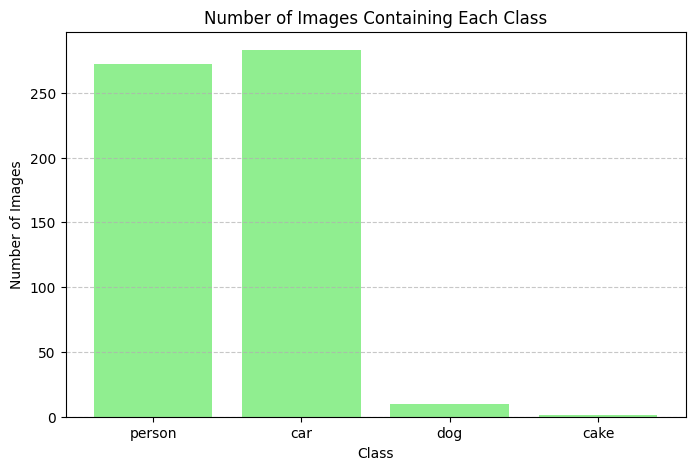

Total images with target classes: 300
Annotations per class: {'person': 1350, 'car': 1061, 'dog': 14, 'cake': 13}
Unique images per class: {'person': 272, 'car': 283, 'dog': 10, 'cake': 1}


In [ ]:
import json
import os
import matplotlib.pyplot as plt
from collections import Counter, defaultdict
from pycocotools.coco import COCO
import cv2
import numpy as np

# Load training annotations
coco = COCO(train_ann_file)

# Define target classes (excluding background)
target_classes = ['car', 'person', 'cake', 'dog']
cat_ids = coco.getCatIds(catNms=target_classes)

# Get annotation IDs and annotations
ann_ids = coco.getAnnIds(catIds=cat_ids)
anns = coco.loadAnns(ann_ids)

# Count annotations per class
class_counts = Counter([coco.loadCats(ann['category_id'])[0]['name'] for ann in anns])

# Plot class distribution
plt.figure(figsize=(8, 5))
plt.bar(class_counts.keys(), class_counts.values(), color='skyblue')
plt.title('Number of Annotations per Class')
plt.ylabel('Count')
plt.xlabel('Class')
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.show()

# Count number of unique images each class appears in
images_per_class = defaultdict(set)
for ann in anns:
    class_name = coco.loadCats(ann['category_id'])[0]['name']
    images_per_class[class_name].add(ann['image_id'])

images_per_class_count = {cls: len(imgs) for cls, imgs in images_per_class.items()}

# Plot number of images per class
plt.figure(figsize=(8, 5))
plt.bar(images_per_class_count.keys(), images_per_class_count.values(), color='lightgreen')
plt.title('Number of Images Containing Each Class')
plt.ylabel('Number of Images')
plt.xlabel('Class')
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.show()

# Print statistics
print(f"Total images with target classes: {len(set([ann['image_id'] for ann in anns]))}")
print(f"Annotations per class: {dict(class_counts)}")
print(f"Unique images per class: {images_per_class_count}")


In [ ]:
class COCODataset(Dataset):
    def __init__(self, images_dir, annotation_file, transforms=None, target_classes=None):
        self.images_dir = images_dir
        self.transforms = transforms

        with open(annotation_file) as f:
            self.coco = json.load(f)

        self.images = {img['id']: img for img in self.coco['images']}
        self.annotations = self.coco['annotations']
        self.cat_id_to_name = {cat['id']: cat['name'] for cat in self.coco['categories']}
        self.target_classes = target_classes or ['car', 'person', 'cake', 'dog']

        # Keep only category ids in target classes
        self.cat_ids = [k for k, v in self.cat_id_to_name.items() if v in self.target_classes]

        # Image IDs that have at least one target class annotation
        self.img_ids = [img_id for img_id in self.images if any(
            ann['image_id'] == img_id and ann['category_id'] in self.cat_ids for ann in self.annotations)]

    def __len__(self):
        return len(self.img_ids)

    def __getitem__(self, idx):
        img_id = self.img_ids[idx]
        img_info = self.images[img_id]
        img_path = os.path.join(self.images_dir, img_info['file_name'])

        img = Image.open(img_path).convert("RGB")

        # Get annotations for image filtered by category ids
        annots = [ann for ann in self.annotations if ann['image_id'] == img_id and ann['category_id'] in self.cat_ids]

        boxes = []
        labels = []
        for ann in annots:
            x, y, w, h = ann['bbox']
            boxes.append([x, y, x + w, y + h])
            # Map category_id to label index in target_classes, +1 for background=0
            labels.append(self.cat_ids.index(ann['category_id']) + 1)

        boxes = torch.as_tensor(boxes, dtype=torch.float32)
        labels = torch.as_tensor(labels, dtype=torch.int64)

        target = {
            "boxes": boxes,
            "labels": labels,
            "image_id": torch.tensor([img_id])
        }

        if self.transforms:
            img = self.transforms(img)

        return img, target
        (self, images_dir, annotation_file, transforms, target_classes)

In [ ]:
!pip install matplotlib

In [ ]:
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from PIL import Image
import random
import torchvision.transforms.functional as F

# Define class labels
id2class = {i: c for i, c in enumerate(['__background__', 'car', 'person', 'cake', 'dog'])}

def coco_style_visualization(dataset, num_samples=4):
    indices = random.sample(range(len(dataset)), num_samples)

    for idx in indices:
        img, target = dataset[idx]
        boxes = target['boxes']
        labels = target['labels']

        img = F.to_pil_image(img)

        fig, ax = plt.subplots(1, figsize=(10, 8))
        ax.imshow(img)

        for box, label in zip(boxes, labels):
            x1, y1, x2, y2 = box.tolist()

            # Draw light blue bounding box
            rect = patches.Rectangle((x1, y1), x2 - x1, y2 - y1,
                                     linewidth=2, edgecolor='skyblue', facecolor='none')
            ax.add_patch(rect)

            # Draw semi-transparent blue fill
            filled_rect = patches.Rectangle((x1, y1), x2 - x1, y2 - y1,
                                            linewidth=0, edgecolor='none',
                                            facecolor='blue', alpha=0.2)
            ax.add_patch(filled_rect)

            # Add class label
            label_text = id2class[label.item()]
            ax.text(x1, y1 - 5, label_text, color='white', fontsize=10,
                    bbox=dict(facecolor='blue', alpha=0.5, boxstyle='round,pad=0.2'))

        ax.axis('off')
        plt.tight_layout()
        plt.show()
        coco_style_visualization(dataset, num_samples)

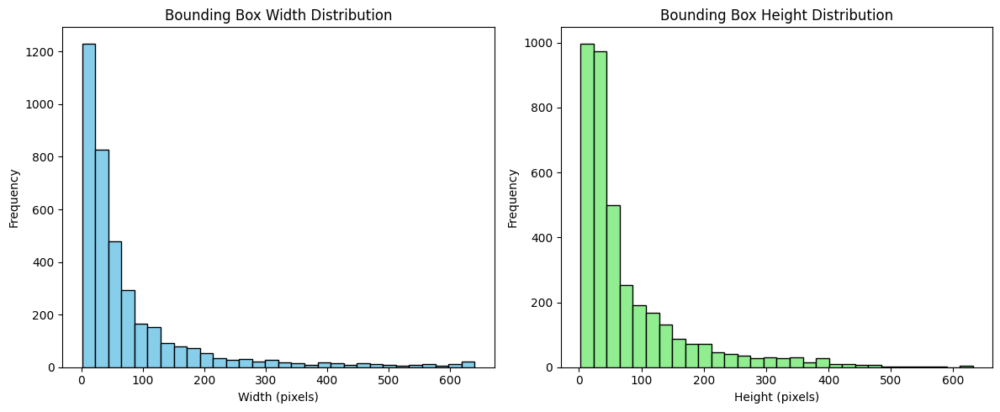

In [ ]:
import os
import json
import matplotlib.pyplot as plt

# Set your unzipped dataset folder path here:
base_dir = "/content/drive/MyDrive/image segmentation "

# Define annotation file path (train or val)
annotation_file = os.path.join(base_dir, "/content/drive/MyDrive/image segmentation /train-300/labels.json")
annotation_file = os.path.join(base_dir, "/content/drive/MyDrive/image segmentation /validation-300/labels.json")

# Load COCO annotations
with open(annotation_file) as f:
    coco = json.load(f)

annotations = coco['annotations']

# Calculate bounding box areas (width * height)
areas = []
for ann in annotations:
    _, _, w, h = ann['bbox']
    area = w * h
    areas.append(area)



# Extract all bounding boxes (bbox format: [x, y, width, height])
bboxes = [ann['bbox'] for ann in coco['annotations']]

# Separate widths and heights
widths = [bbox[2] for bbox in bboxes]
heights = [bbox[3] for bbox in bboxes]

# Plot histogram for widths and heights
plt.figure(figsize=(12, 5))

plt.subplot(1, 2, 1)
plt.hist(widths, bins=30, color='skyblue', edgecolor='black')
plt.title('Bounding Box Width Distribution')
plt.xlabel('Width (pixels)')
plt.ylabel('Frequency')

plt.subplot(1, 2, 2)
plt.hist(heights, bins=30, color='lightgreen', edgecolor='black')
plt.title('Bounding Box Height Distribution')
plt.xlabel('Height (pixels)')
plt.ylabel('Frequency')

plt.tight_layout()
plt.show()




In [ ]:
!ls -R "/content/drive/MyDrive/image segmentation /train-300"


'/content/drive/MyDrive/image segmentation /train-300':
data  labels.json

'/content/drive/MyDrive/image segmentation /train-300/data':
000000000064.jpg  000000003160.jpg  000000007650.jpg  000000012726.jpg
000000000071.jpg  000000003272.jpg  000000007685.jpg  000000012818.jpg
000000000094.jpg  000000003337.jpg  000000007726.jpg  000000012861.jpg
000000000110.jpg  000000003493.jpg  000000007819.jpg  000000012891.jpg
000000000149.jpg  000000003535.jpg  000000007938.jpg  000000012946.jpg
000000000247.jpg  000000003590.jpg  000000008019.jpg  000000012993.jpg
000000000260.jpg  000000003602.jpg  000000008025.jpg  000000013082.jpg
000000000307.jpg  000000003668.jpg  000000008086.jpg  000000013143.jpg
000000000328.jpg  000000003711.jpg  000000008187.jpg  000000013172.jpg
000000000359.jpg  000000003793.jpg  000000008309.jpg  000000013198.jpg
000000000397.jpg  000000003804.jpg  000000008339.jpg  000000013230.jpg
000000000419.jpg  000000003817.jpg  000000008593.jpg  000000013258.jpg
000000000471

🔍 Objects found in dataset:
car: 1061
person: 1350
cake: 13
dog: 14


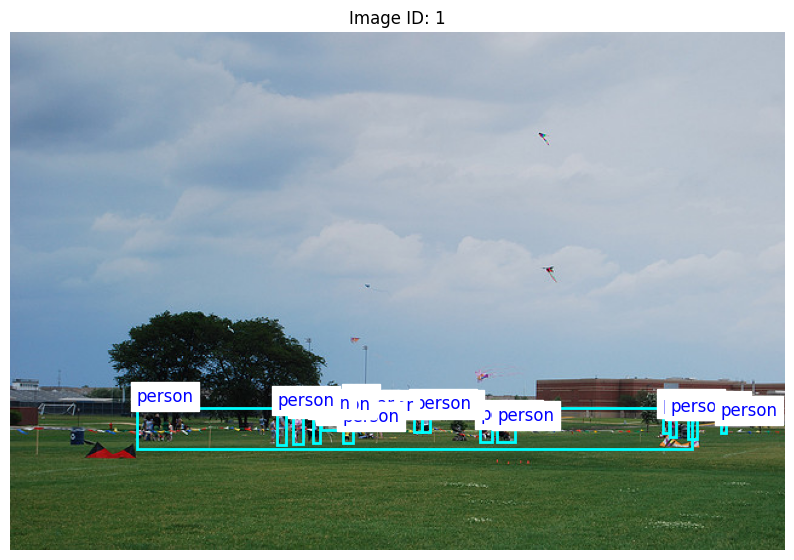

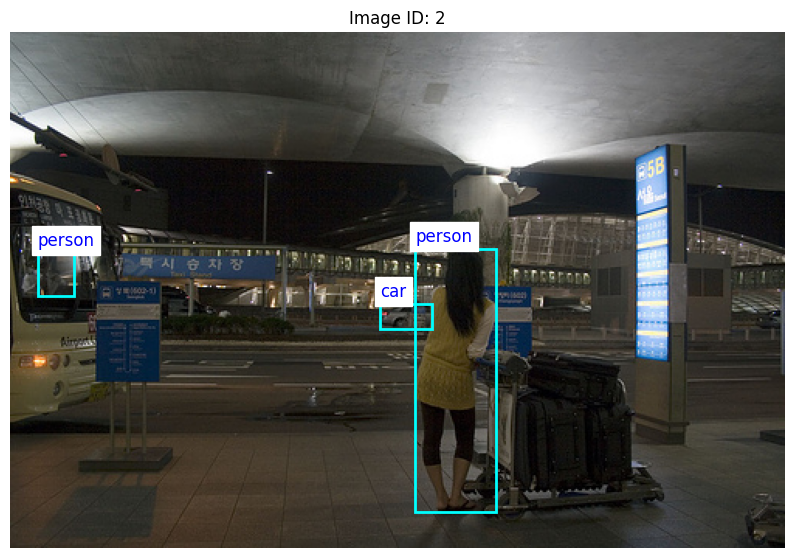

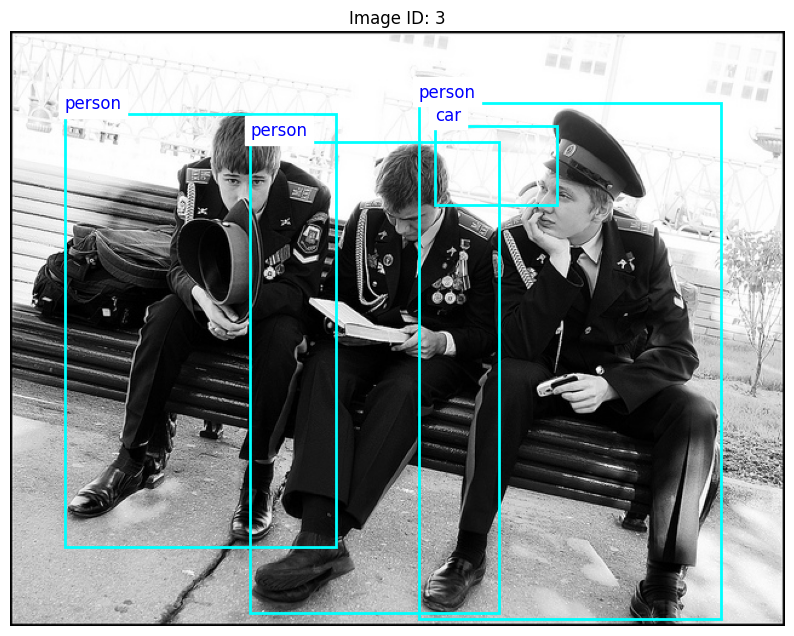

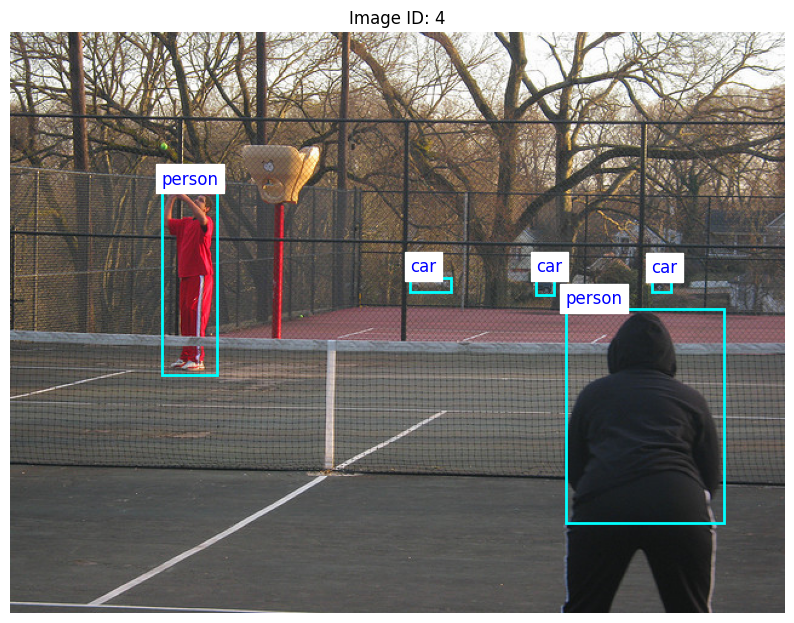

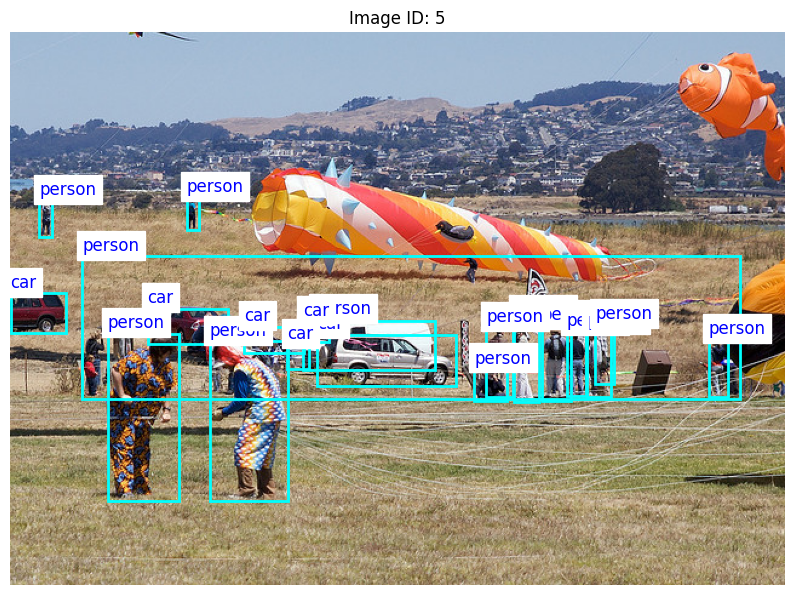

...

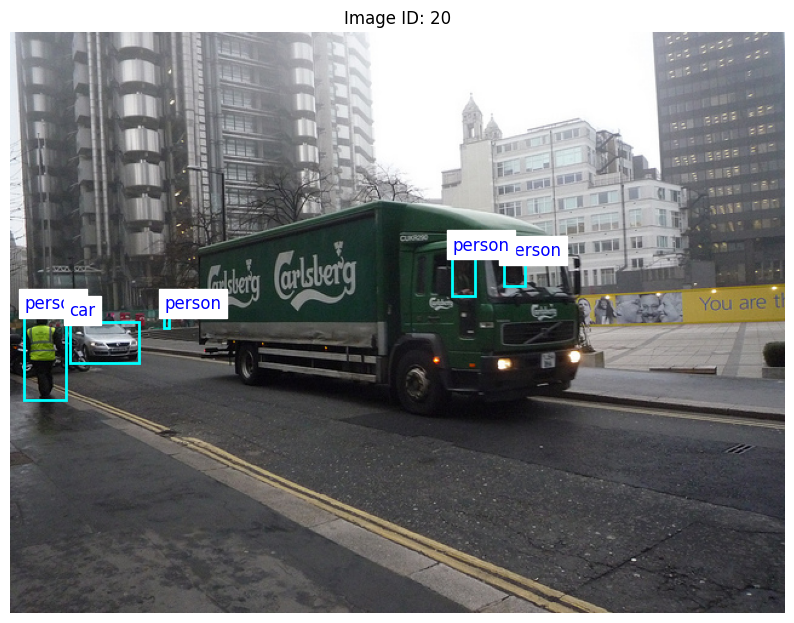

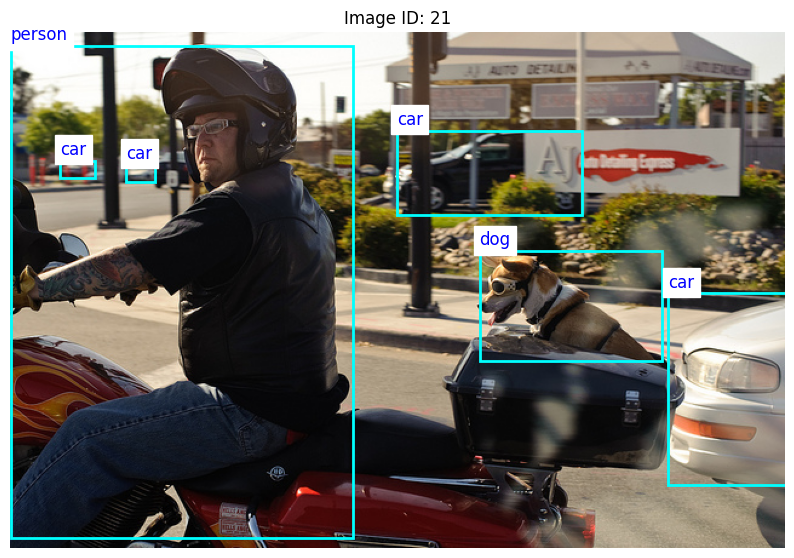

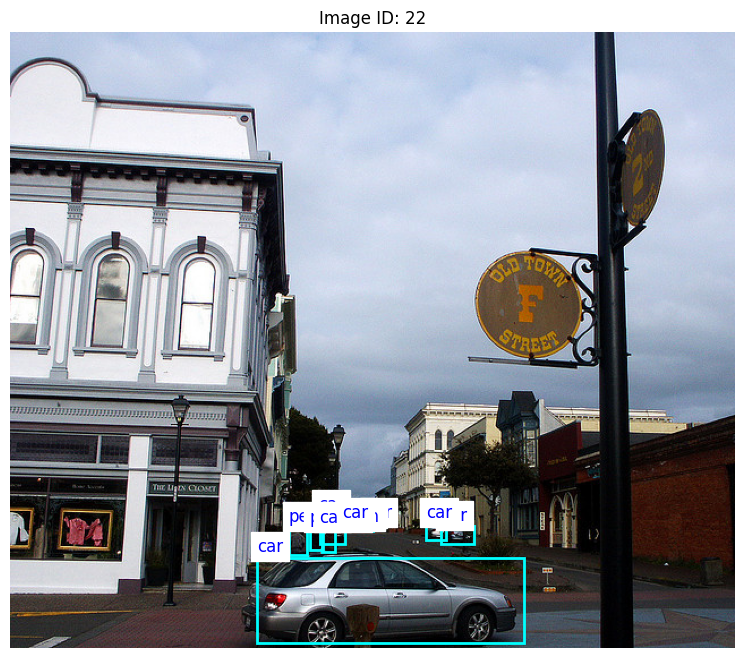

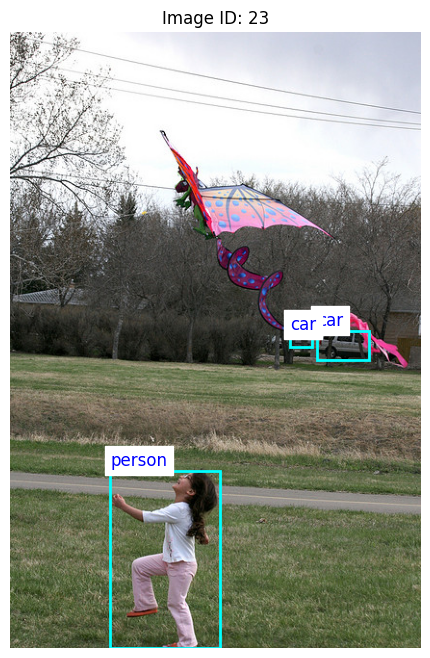

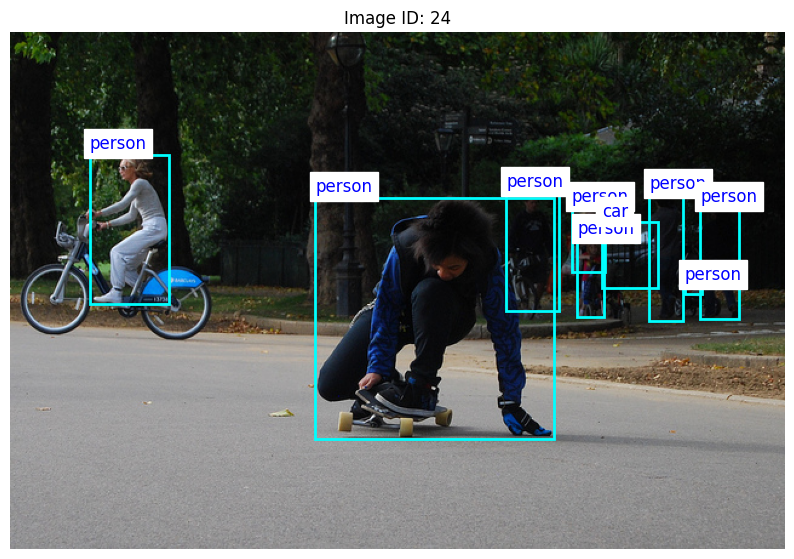

In [ ]:
import os
import json
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from PIL import Image
from collections import defaultdict

# Set paths
images_dir = "/content/drive/MyDrive/image segmentation /train-300/data"
annotation_file = "/content/drive/MyDrive/image segmentation /train-300/labels.json"

# Set target classes
target_classes = ['car', 'person', 'cake', 'dog']

# Load COCO annotations
with open(annotation_file, 'r') as f:
    coco = json.load(f)

# Category mappings
cat_id_to_name = {cat['id']: cat['name'] for cat in coco['categories']}
cat_name_to_id = {v: k for k, v in cat_id_to_name.items() if v in target_classes}

# Image info
img_id_to_file = {img['id']: img['file_name'] for img in coco['images']}

# Group annotations by image
img_to_anns = defaultdict(list)
class_counts = defaultdict(int)

for ann in coco['annotations']:
    cat_name = cat_id_to_name.get(ann['category_id'])
    if cat_name in target_classes:
        img_to_anns[ann['image_id']].append(ann)
        class_counts[cat_name] += 1

# Print how many objects found per class
print("🔍 Objects found in dataset:")
for cls in target_classes:
    print(f"{cls}: {class_counts.get(cls, 0)}")

# Visualize images containing any of the target objects
def visualize_target_samples(num_images=5):
    shown = 0
    for img_id, anns in img_to_anns.items():
        if shown >= num_images:
            break

        img_file = img_id_to_file.get(img_id)
        img_path = os.path.join(images_dir, img_file)

        if not os.path.exists(img_path):
            continue

        image = Image.open(img_path).convert("RGB")
        plt.figure(figsize=(10, 8))
        plt.imshow(image)
        ax = plt.gca()

        for ann in anns:
            x, y, w, h = ann['bbox']
            label = cat_id_to_name[ann['category_id']]
            rect = patches.Rectangle((x, y), w, h, linewidth=2, edgecolor='cyan', facecolor='none')
            ax.add_patch(rect)
            ax.text(x, y - 5, label, color='blue', fontsize=12, backgroundcolor='white')

        plt.axis('off')
        plt.title(f"Image ID: {img_id}")
        plt.show()
        shown += 1

visualize_target_samples(num_images=24)


In [ ]:
import torch
from torchvision import datasets, transforms as T
from torch.utils.data import DataLoader, Subset

def get_transform(train=True):
    transforms = [T.ToTensor()]
    if train:
        transforms.append(T.RandomHorizontalFlip(0.5))
    return T.Compose(transforms)

train_dir = '/content/drive/MyDrive/image segmentation /train-300'
val_dir = '/content/drive/MyDrive/image segmentation /validation-300'

# Load full datasets without transforms
full_train_dataset = datasets.ImageFolder(train_dir)
full_val_dataset = datasets.ImageFolder(val_dir)

print("Train classes:", full_train_dataset.classes)
print("Val classes:", full_val_dataset.classes)

# Set allowed classes to filter (replace with your classes or keep all)
allowed_classes = ['class1', 'class2']  # Example, replace with your actual class names

# Filter indices by allowed classes for train and val
train_indices = [i for i, (_, label) in enumerate(full_train_dataset.samples)
                 if full_train_dataset.classes[label] in allowed_classes]

val_indices = [i for i, (_, label) in enumerate(full_val_dataset.samples)
               if full_val_dataset.classes[label] in allowed_classes]

# Fallback to full dataset if filtering results in empty set
if len(train_indices) == 0:

    train_dataset = full_train_dataset
else:
    train_dataset = Subset(full_train_dataset, train_indices)

if len(val_indices) == 0:

    val_dataset = full_val_dataset
else:
    val_dataset = Subset(full_val_dataset, val_indices)

# Wrap Subset datasets to apply transforms
class DatasetWithTransform(torch.utils.data.Dataset):
    def __init__(self, dataset, transform):
        self.dataset = dataset
        self.transform = transform

    def __getitem__(self, idx):
        img, label = self.dataset[idx]
        if self.transform:
            img = self.transform(img)
        return img, label

    def __len__(self):
        return len(self.dataset)

train_dataset = DatasetWithTransform(train_dataset, get_transform(train=True))
val_dataset = DatasetWithTransform(val_dataset, get_transform(train=False))

print(f"Filtered train dataset samples: {len(train_dataset)}")
print(f"Filtered val dataset samples: {len(val_dataset)}")

train_loader = DataLoader(train_dataset, batch_size=32, shuffle=True, num_workers=4)
val_loader = DataLoader(val_dataset, batch_size=32, shuffle=False, num_workers=4)


Train classes: ['data']
Val classes: ['data']
Filtered train dataset samples: 300
Filtered val dataset samples: 300


/usr/local/lib/python3.11/dist-packages/torch/utils/data/dataloader.py:624: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(


In [ ]:
import torch
import torch.nn as nn
import torch.optim as optim
from torchvision import models
from torchvision.models import ResNet18_Weights  # import weights enum

num_classes = len(full_train_dataset.classes)  # or your filtered classes

# Initialize model with updated weights argument (no warning)
model = models.resnet18(weights=ResNet18_Weights.IMAGENET1K_V1)

# Replace final layer for your number of classes
model.fc = nn.Linear(model.fc.in_features, num_classes)

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model = model.to(device)

optimizer = optim.Adam(model.parameters(), lr=1e-3)
criterion = nn.CrossEntropyLoss()

print(f"Model initialized on device: {device}")
print(f"Number of classes: {num_classes}")
print(f"Optimizer: {optimizer}")
print(f"Loss function: {criterion}")


Downloading: "https://download.pytorch.org/models/resnet18-f37072fd.pth" to /root/.cache/torch/hub/checkpoints/resnet18-f37072fd.pth
100%|██████████| 44.7M/44.7M [00:01<00:00, 45.8MB/s]


Model initialized on device: cpu
Number of classes: 1
Optimizer: Adam (
Parameter Group 0
    amsgrad: False
    betas: (0.9, 0.999)
    capturable: False
    differentiable: False
    eps: 1e-08
    foreach: None
    fused: None
    lr: 0.001
    maximize: False
    weight_decay: 0
)
Loss function: CrossEntropyLoss()


In [ ]:
from torchvision import datasets, transforms
from torch.utils.data import DataLoader, random_split

# Define your transforms (resize, normalization, etc.)
transform = transforms.Compose([
    transforms.Resize((128, 128)),  # or any size you want
    transforms.ToTensor(),
])

# Fixed path: removed trailing space after 'segmentation'
dataset = datasets.ImageFolder('/content/drive/MyDrive/image segmentation /train-300', transform=transform)

# Print dataset info to confirm
print(f'Classes found: {dataset.classes}')
print(f'Total images: {len(dataset)}')

# Split into train and val
train_size = int(0.8 * len(dataset))
val_size = len(dataset) - train_size
train_dataset, val_dataset = random_split(dataset, [train_size, val_size])

# Create DataLoaders with num_workers=0 (safe default to avoid warnings)
train_loader = DataLoader(train_dataset, batch_size=32, shuffle=True, num_workers=0)
val_loader = DataLoader(val_dataset, batch_size=32, shuffle=False, num_workers=0)


Classes found: ['data']
Total images: 300


In [ ]:
@torch.no_grad()
def evaluate(model, data_loader, device):
    model.eval()
    total_samples = 0
    # You can accumulate metrics here (like mAP), or just print stats
    for images, targets in data_loader:
        images = list(img.to(device) for img in images)
        outputs = model(images)  # outputs is a list of dicts with boxes, masks, scores, labels

        # Just example: print number of detected instances in first batch item
        print(f"Detected instances: {len(outputs[0]['boxes'])}")

        total_samples += len(images)

    print(f"Evaluated {total_samples} samples.")


In [ ]:
import torch
import torchvision
from torchvision.models.detection.faster_rcnn import FastRCNNPredictor
from torch.utils.data import DataLoader
import torchvision.transforms as T
from tqdm import tqdm
import matplotlib.pyplot as plt

# --- Model Setup ---
def get_model(num_classes):
    model = torchvision.models.detection.fasterrcnn_resnet50_fpn(pretrained=True)
    in_features = model.roi_heads.box_predictor.cls_score.in_features
    model.roi_heads.box_predictor = FastRCNNPredictor(in_features, num_classes)
    return model

# --- Transform ---
transform = T.Compose([T.ToTensor()])

# --- Dataset and DataLoader ---
train_dataset = COCODataset(train_images_dir, train_ann_file, transforms=transform, target_classes=['car', 'person', 'cake', 'dog'])
val_dataset = COCODataset(val_images_dir, val_ann_file, transforms=transform, target_classes=['car', 'person', 'cake', 'dog'])

train_loader = DataLoader(train_dataset, batch_size=4, shuffle=True, collate_fn=lambda x: tuple(zip(*x)))
val_loader = DataLoader(val_dataset, batch_size=4, shuffle=False, collate_fn=lambda x: tuple(zip(*x)))

# --- Model Init ---
device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')
model = get_model(num_classes=5).to(device)

# --- Optimizer ---
params = [p for p in model.parameters() if p.requires_grad]
optimizer = torch.optim.SGD(params, lr=0.005, momentum=0.9, weight_decay=0.0005)

# --- Training Loop ---
num_epochs = 20
train_losses, val_losses = [], []

for epoch in range(num_epochs):
    print(f"\nEpoch {epoch + 1}/{num_epochs}")

    model.train()
    running_loss = 0.0
    for images, targets in tqdm(train_loader, desc='Training'):
        images = [img.to(device) for img in images]
        targets = [{k: v.to(device) for k, v in t.items()} for t in targets]

        loss_dict = model(images, targets)
        losses = sum(loss for loss in loss_dict.values())

        optimizer.zero_grad()
        losses.backward()
        optimizer.step()

        running_loss += losses.item()

    avg_train_loss = running_loss / len(train_loader)
    train_losses.append(avg_train_loss)

    model.eval()
    val_loss = 0.0
    with torch.no_grad():
        for images, targets in tqdm(val_loader, desc='Validating'):
            images = [img.to(device) for img in images]
            targets = [{k: v.to(device) for k, v in t.items()} for t in targets]

            loss_dict = model(images, targets)
            losses = sum(loss for loss in loss_dict.values())
            val_loss += losses.item()

    avg_val_loss = val_loss / len(val_loader)
    val_losses.append(avg_val_loss)

    print(f"Train Loss: {avg_train_loss:.4f} | Val Loss: {avg_val_loss:.4f}")

# --- Plotting ---
plt.figure(figsize=(8, 5))
plt.plot(range(1, num_epochs + 1), train_losses, label="Train Loss", color='blue')
plt.plot(range(1, num_epochs + 1), val_losses, label="Validation Loss", color='orange')
plt.xlabel("Epoch")
plt.ylabel("Loss")
plt.title("Training and Validation Loss")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()
